# Детекция объектов в видеопотоке с помощью YOLO: анализ производительности и оптимизация

---

## Информация об авторе

**Автор:** Павел Николаев

**Дата:** Декабрь 2025

---

## Аннотация

**Актуальность:**

Детекция объектов в видеопотоке является одной из ключевых задач компьютерного зрения, требующих обработки в реальном времени с высокой точностью и скоростью. Это особенно важно для приложений, таких как:
- Системы видеонаблюдения и мониторинга дорожного движения
- Автономное вождение и помощь водителю
- Анализ трафика и управление транспортными потоками

**Цель работы:**

Исследовать производительность алгоритмов семейства YOLO (You Only Look Once) при детекции транспортных средств в видеопотоке и оптимизировать модель для работы в реальном времени.

**Задачи исследования:**

1. Подготовка датасета UA-DETRAC для обучения модели YOLO
2. Обучение и тонкая настройка модели YOLOv8 для детекции транспортных средств
3. Анализ производительности модели на тестовом наборе данных
4. Оценка скорости обработки видеопотока и возможности работы в реальном времени
5. Оптимизация модели для достижения баланса между точностью и скоростью

**Методы исследования:**

- Использование современных архитектур YOLOv8 для детекции объектов
- Fine-tuning предобученных моделей на специализированном датасете
- Метрики оценки: mAP (mean Average Precision), Precision, Recall, FPS
- Обработка видеопотока с измерением производительности

In [ ]:
#@title Установка зависимостей
!pip install -q kagglehub tqdm ultralytics xmltodict torch matplotlib gdown moviepy > /dev/null 2>&1

# ТЕОРЕТИЧЕСКАЯ ЧАСТЬ

## 1. Краткое описание проблемы

Детекция объектов в видеопотоке представляет собой сложную задачу компьютерного зрения, которая требует одновременного решения нескольких проблем:

### Основные вызовы:

1. **Обработка в реальном времени**: Видеопоток требует обработки с высокой частотой кадров (обычно 25-30 FPS) без задержек
2. **Изменяющиеся условия**: Освещение, погода, угол обзора меняются между кадрами
3. **Динамические объекты**: Транспортные средства движутся с разной скоростью и могут частично перекрываться
4. **Масштабирование**: Размер объектов в кадре сильно варьируется в зависимости от расстояния
5. **Классовая несбалансированность**: Некоторые классы объектов встречаются реже других

### Практическая значимость:

Решение задачи детекции объектов в видеопотоке критически важно для:
- **Интеллектуальных транспортных систем**: мониторинг дорожного движения, подсчет транспорта
- **Автономного вождения**: обнаружение и классификация транспортных средств, пешеходов
- **Систем безопасности**: видеонаблюдение в реальном времени, обнаружение инцидентов

## 2. Основные концепции

### YOLO (You Only Look Once)

YOLO - это семейство архитектур детекции объектов, которое решает задачу детекции как задачу регрессии. В отличие от двухстадийных методов (R-CNN, Fast R-CNN), YOLO выполняет детекцию за один проход через нейронную сеть.

### Принцип работы YOLO:

1. **Разделение на сетку**: Входное изображение делится на сетку (например, 13×13 для YOLOv3, 640×640 для YOLOv8)
2. **Предсказание для каждой ячейки**: Каждая ячейка сетки отвечает за детекцию объектов, центры которых попадают в эту ячейку
3. **Единый проход**: Все предсказания (bounding boxes, классы, уверенность) делаются одновременно за один forward pass

### Основные преимущества YOLO:

- **Скорость**: Обработка изображения за один проход через сеть (real-time inference)
- **Точность**: Современные версии (YOLOv8, YOLOv9) достигают высокой точности (mAP > 50%)
- **Эффективность**: Оптимизирована для работы на GPU, подходит для embedded систем
- **Простота**: Единая архитектура для локализации и классификации

## 3. Математическое обоснование

### Функция потерь YOLO

YOLO использует комбинированную функцию потерь, состоящую из нескольких компонентов, которые оптимизируются совместно:

#### 1. Потеря локализации (Localization Loss)

Оценивает точность предсказания координат bounding box:

$$L_{coord} = \lambda_{coord} \sum_{i=0}^{S^2} \sum_{j=0}^{B} \mathbb{1}_{ij}^{obj} \left[ (x_i - \hat{x}_i)^2 + (y_i - \hat{y}_i)^2 + (\sqrt{w_i} - \sqrt{\hat{w}_i})^2 + (\sqrt{h_i} - \sqrt{\hat{h}_i})^2 \right]$$

**Обозначения:**
- $S^2$ - количество ячеек сетки
- $B$ - количество bounding boxes на ячейку (обычно 2-3)
- $\mathbb{1}_{ij}^{obj}$ - индикатор наличия объекта в ячейке $i$ и box $j$ (равен 1, если объект присутствует, иначе 0)
- $(x, y)$ - координаты центра bounding box (нормализованные)
- $(w, h)$ - ширина и высота bounding box (нормализованные)
- $\lambda_{coord}$ - весовой коэффициент (обычно 5)

**Особенность**: Использование $\sqrt{w}$ и $\sqrt{h}$ вместо просто $w$ и $h$ помогает лучше учитывать ошибки для маленьких объектов.

#### 2. Потеря уверенности (Confidence Loss)

Оценивает, насколько модель уверена в наличии объекта:

$$L_{conf} = \sum_{i=0}^{S^2} \sum_{j=0}^{B} \left[ \mathbb{1}_{ij}^{obj} (C_i - \hat{C}_i)^2 + \lambda_{noobj} \mathbb{1}_{ij}^{noobj} (C_i - \hat{C}_i)^2 \right]$$

где:
- $C_i$ - предсказанная уверенность (вероятность наличия объекта)
- $\hat{C}_i$ - истинная уверенность (1 для объектов, 0 для фона)
- $\lambda_{noobj}$ - весовой коэффициент для фоновых объектов (обычно 0.5)

#### 3. Потеря классификации (Classification Loss)

Оценивает точность предсказания класса объекта:

$$L_{class} = \sum_{i=0}^{S^2} \mathbb{1}_{i}^{obj} \sum_{c \in classes} (p_i(c) - \hat{p}_i(c))^2$$

где:
- $p_i(c)$ - предсказанная вероятность класса $c$
- $\hat{p}_i(c)$ - истинная вероятность класса $c$ (one-hot encoding)

#### Общая функция потерь

$$L_{total} = L_{coord} + L_{conf} + L_{class}$$

Все компоненты минимизируются одновременно в процессе обучения с помощью backpropagation.

### Метрики оценки качества детекции

#### Intersection over Union (IoU)

Мера перекрытия между предсказанным и истинным bounding box:

$$\text{IoU} = \frac{\text{Area of Intersection}}{\text{Area of Union}} = \frac{A \cap B}{A \cup B}$$

IoU варьируется от 0 (нет перекрытия) до 1 (полное совпадение). Пороговое значение IoU = 0.5 обычно используется для определения правильной детекции.

#### Precision и Recall

- **Precision (Точность)**: Доля правильно детектированных объектов среди всех предсказаний
  $$\text{Precision} = \frac{TP}{TP + FP}$$

- **Recall (Полнота)**: Доля правильно детектированных объектов среди всех истинных объектов
  $$\text{Recall} = \frac{TP}{TP + FN}$$

где:
- $TP$ (True Positive) - правильно детектированные объекты
- $FP$ (False Positive) - ложные срабатывания
- $FN$ (False Negative) - пропущенные объекты

#### Average Precision (AP) и mAP

- **AP (Average Precision)**: Средняя точность для одного класса, вычисляется как площадь под кривой Precision-Recall

- **mAP@0.5**: Среднее AP по всем классам при IoU threshold = 0.5

- **mAP@0.5:0.95**: Среднее AP по всем классам и по IoU от 0.5 до 0.95 с шагом 0.05 (более строгая метрика)

## 4. Оптимизация для видеопотока

При работе с видеопотоком важно учитывать специфические требования:

1. **Временная согласованность**: Объекты в соседних кадрах должны быть согласованы по положению и размеру
2. **Трекинг объектов**: Отслеживание объектов между кадрами для стабильности детекции
3. **Баланс точности и скорости**: Необходимость обработки 25-30 FPS при сохранении приемлемой точности

## Методы оптимизации:

- **Выбор модели**: Использование более легких версий (YOLOv8n, YOLOv8s) для реального времени
- **Оптимизация разрешения**: Уменьшение входного разрешения (например, 640×640 вместо 1280×1280)
- **Batch processing**: Обработка нескольких кадров одновременно на GPU
- **TensorRT/ONNX**: Конвертация модели в оптимизированный формат для ускорения инференса
- **Квантизация**: Использование INT8 вместо FP32 для ускорения на некоторых устройствах

## Схема архитектуры YOLOv8

### Архитектура YOLOv8

YOLOv8 использует модифицированную архитектуру, состоящую из трех основных компонентов:

#### 1. Backbone (CSPDarknet)
- **Назначение**: Извлечение признаков из изображения
- **Структура**: Последовательность сверточных слоев с Residual connections
- **Особенности**:
  - CSP (Cross Stage Partial) блоки для эффективного обучения
  - SPPF (Spatial Pyramid Pooling Fast) для работы с объектами разного размера
  - Feature maps на разных уровнях (разные разрешения)

#### 2. Neck (FPN + PANet)
- **Назначение**: Объединение признаков разных масштабов
- **FPN (Feature Pyramid Network)**: Top-down путь для передачи семантической информации
- **PANet (Path Aggregation Network)**: Bottom-up путь для передачи локализационной информации
- **Результат**: Три уровня признаков (P3, P4, P5) для детекции объектов разного размера

#### 3. Head (Decoupled Head)
- **Назначение**: Предсказание bounding boxes, классов и уверенности
- **Структура**: Раздельные ветви для классификации и регрессии (decoupled)
- **Выходы**:
  - Координаты bbox для каждого якоря
  - Уверенность наличия объекта
  - Вероятности классов

### Особенности YOLOv8:

1. **Anchor-free детекция**: Не требует предопределенных якорей, предсказывает центры объектов напрямую
2. **Decoupled Head**: Раздельные ветви для классификации и локализации улучшают производительность
3. **Масштабируемость**: От nano (n) до extra-large (x) версии с разным числом параметров
4. **Оптимизация**: Улучшенная архитектура для баланса скорости и точности

In [ ]:
#@title Импорты

import os
import random
import warnings
import shutil
import xml.etree.ElementTree as ET
import time
import glob
import subprocess
import sys
from collections import Counter
from pathlib import Path

from PIL import Image
from tqdm import tqdm
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

import torch
import kagglehub
from ultralytics import YOLO

import cv2
import gdown
from IPython.display import HTML, display, clear_output, Video
from moviepy.editor import ImageSequenceClip

warnings.filterwarnings("ignore")

Creating new Ultralytics Settings v0.0.6 file ✅ 
View Ultralytics Settings with 'yolo settings' or at '/root/.config/Ultralytics/settings.json'
Update Settings with 'yolo settings key=value', i.e. 'yolo settings runs_dir=path/to/dir'. For help see https://docs.ultralytics.com/quickstart/#ultralytics-settings.


/usr/local/lib/python3.12/dist-packages/moviepy/config_defaults.py:47: SyntaxWarning: invalid escape sequence '\P'
  IMAGEMAGICK_BINARY = r"C:\Program Files\ImageMagick-6.8.8-Q16\magick.exe"
/usr/local/lib/python3.12/dist-packages/moviepy/video/io/ffmpeg_reader.py:294: SyntaxWarning: invalid escape sequence '\d'
  lines_video = [l for l in lines if ' Video: ' in l and re.search('\d+x\d+', l)]
/usr/local/lib/python3.12/dist-packages/moviepy/video/io/ffmpeg_reader.py:367: SyntaxWarning: invalid escape sequence '\d'
  rotation_lines = [l for l in lines if 'rotate          :' in l and re.search('\d+$', l)]
/usr/local/lib/python3.12/dist-packages/moviepy/video/io/ffmpeg_reader.py:370: SyntaxWarning: invalid escape sequence '\d'
  match = re.search('\d+$', rotation_line)
  if event.key is 'enter':



In [ ]:
#@title Константы и пути

# Константы
CLASS_MAPPING = {
    'car': 0,
    'bus': 1,
    'van': 2,
    'others': 3,
}
CLASS_NAMES = list(CLASS_MAPPING.keys())
NUM_CLASSES = len(CLASS_NAMES)

# Пропорция разделения данных
TRAIN_RATIO = 0.7
VAL_RATIO = 0.15
TEST_RATIO = 0.15

# Пути

# Загрузка датасета с Kaggle
KAGGLE_DATASET_REF = "bratjay/ua-detrac-orig"

# Папки для исходных данных (после загрузки)
KAGGLE_INPUT_PATH = '/content/datasets/bratjay/ua-detrac-orig'

# Корневая папка для обработанных данных в формате YOLO
YOLO_ROOT_PATH = '/content/UA-DETRAC-YOLO'

# Исходные подпапки в Kaggle-датасете
IMAGES_DIR = os.path.join(KAGGLE_INPUT_PATH, 'DETRAC-Images', 'DETRAC-Images')
ANNOTATIONS_DIR = os.path.join(KAGGLE_INPUT_PATH, 'DETRAC-Train-Annotations-XML', 'DETRAC-Train-Annotations-XML')

# Проверка устройства
DEVICE = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Используемое устройство: {DEVICE}")

# Параметры обучения модели
TRAIN_EPOCHS = 5      # Количество эпох
TRAIN_IMGSZ = 640     # Размер входного изображения
TRAIN_BATCH = 16      # Размер батча
TRAIN_PATIENCE = 3    # Ранняя остановка (patience)

# Параметры модели
MODEL_SIZE = 'yolov8s.pt'  # Размер модели (yolov8n, yolov8s, yolov8m, yolov8l, yolov8x)

# Параметры проекта
PROJECT_NAME = 'UA-DETRAC-YOLO'
EXPERIMENT_NAME = 'yolov8s_training'

# Путь к конфигурации датасета
YAML_PATH = os.path.join(YOLO_ROOT_PATH, 'ua_detrac.yaml')

print(f"\nВсего классов: {NUM_CLASSES} -> {CLASS_NAMES}")
print(f"Обработанные данные будут сохранены в: {YOLO_ROOT_PATH}")

Используемое устройство: cuda

Всего классов: 4 -> ['car', 'bus', 'van', 'others']
Обработанные данные будут сохранены в: /content/UA-DETRAC-YOLO


In [ ]:
#@title Вспомогательные функции для конвертации и подготовки

def convert_to_yolo_format(xmin, ymin, width, height, img_width, img_height, class_id):
    """
    Конвертирует координаты Bounding Box из формата DETRAC (xmin, ymin, width, height)
    в нормализованный формат YOLO (class_id, x_center, y_center, width_norm, height_norm).

    Args:
        xmin: Левая координата bbox в пикселях
        ymin: Верхняя координата bbox в пикселях
        width: Ширина bbox в пикселях
        height: Высота bbox в пикселях
        img_width: Ширина изображения в пикселях
        img_height: Высота изображения в пикселях
        class_id: ID класса объекта

    Returns:
        Строка в формате YOLO: "class_id x_center y_center width_norm height_norm"
        или None, если размеры изображения невалидны
    """
    if img_width <= 0 or img_height <= 0:
        return None

    x_center = (xmin + width / 2.0) / img_width
    y_center = (ymin + height / 2.0) / img_height
    w_norm = width / img_width
    h_norm = height / img_height

    return f"{class_id} {x_center:.6f} {y_center:.6f} {w_norm:.6f} {h_norm:.6f}"


def prepare_yolo_directories(root_path):
    """
    Создает необходимую структуру папок для формата YOLO.

    Args:
        root_path: Корневая директория для создания структуры папок
    """
    subdirs = [
        'images/train', 'images/val', 'images/test',
        'labels/train', 'labels/val', 'labels/test'
    ]
    for subdir in subdirs:
        os.makedirs(os.path.join(root_path, subdir), exist_ok=True)
    print("Структура папок YOLO создана.")

In [ ]:
#@title Загрузка датасета с KaggleHub

# Проверка, загружен ли датасет
def check_dataset_exists(images_dir, annotations_dir):
    """
    Проверяет наличие загруженного датасета.

    Args:
        images_dir: Путь к папке с изображениями
        annotations_dir: Путь к папке с XML аннотациями

    Returns:
        tuple: (bool, int) - (существует ли датасет, количество XML файлов)
    """
    images_exist = os.path.exists(images_dir) and os.path.isdir(images_dir)
    annotations_exist = os.path.exists(annotations_dir) and os.path.isdir(annotations_dir)

    if images_exist and annotations_exist:
        try:
            xml_files = [f for f in os.listdir(annotations_dir) if f.endswith('.xml')]
            if len(xml_files) > 0:
                return True, len(xml_files)
        except (OSError, PermissionError):
            pass
    return False, 0

# Проверка существования датасета
dataset_exists, xml_count = check_dataset_exists(IMAGES_DIR, ANNOTATIONS_DIR)

if dataset_exists:
    print(f"✅ Датасет уже загружен!")
    print(f"   Путь к изображениям: {IMAGES_DIR}")
    print(f"   Путь к аннотациям: {ANNOTATIONS_DIR}")
    print(f"   Найдено XML файлов: {xml_count}")
else:
    print(f"Загрузка датасета '{KAGGLE_DATASET_REF}'...")
    try:
        path = kagglehub.dataset_download(KAGGLE_DATASET_REF)
        print(f"✅ Датасет загружен в: {path}")

        if path and path != KAGGLE_INPUT_PATH:
            print(f"⚠️  ВНИМАНИЕ: KAGGLE_INPUT_PATH был изменен на {path}")
            KAGGLE_INPUT_PATH = path
            IMAGES_DIR = os.path.join(KAGGLE_INPUT_PATH, 'DETRAC-Images', 'DETRAC-Images')
            ANNOTATIONS_DIR = os.path.join(KAGGLE_INPUT_PATH, 'DETRAC-Train-Annotations-XML', 'DETRAC-Train-Annotations-XML')

        dataset_exists, xml_count = check_dataset_exists(IMAGES_DIR, ANNOTATIONS_DIR)
        if dataset_exists:
            print(f"✅ Проверка пройдена: найдено {xml_count} XML файлов")
        else:
            print("⚠️  Предупреждение: Датасет загружен, но папки не найдены по ожидаемым путям")

    except Exception as e:
        print(f"❌ Ошибка при загрузке датасета: {e}")
        raise

# Финальная проверка перед продолжением
if not os.path.exists(IMAGES_DIR) or not os.path.exists(ANNOTATIONS_DIR):
    raise FileNotFoundError(
        f"Критическая ошибка: Не найдены необходимые папки!\n"
        f"  IMAGES_DIR: {IMAGES_DIR} (существует: {os.path.exists(IMAGES_DIR)})\n"
        f"  ANNOTATIONS_DIR: {ANNOTATIONS_DIR} (существует: {os.path.exists(ANNOTATIONS_DIR)})"
    )

Загрузка датасета 'bratjay/ua-detrac-orig'...
Using Colab cache for faster access to the 'ua-detrac-orig' dataset.
✅ Датасет загружен в: /kaggle/input/ua-detrac-orig
⚠️  ВНИМАНИЕ: KAGGLE_INPUT_PATH был изменен на /kaggle/input/ua-detrac-orig
✅ Проверка пройдена: найдено 60 XML файлов


In [ ]:
#@title Конвертация аннотаций в формат YOLO

# Создание структуры папок
prepare_yolo_directories(YOLO_ROOT_PATH)

def process_detrac_annotations():
    """
    Конвертирует аннотации UA-DETRAC из XML формата в формат YOLO.

    Обрабатывает все XML файлы из ANNOTATIONS_DIR, извлекает bounding boxes,
    конвертирует их в формат YOLO и сохраняет изображения и метки во временную
    папку 'images/all' и 'labels/all' для последующего разделения.

    Returns:
        int: Количество успешно обработанных изображений
    """
    print("\nНачало конвертации аннотаций...")

    # Создание временной общей папки для всех данных перед разделением
    temp_images_path = os.path.join(YOLO_ROOT_PATH, 'images/all')
    temp_labels_path = os.path.join(YOLO_ROOT_PATH, 'labels/all')
    os.makedirs(temp_images_path, exist_ok=True)
    os.makedirs(temp_labels_path, exist_ok=True)

    processed_count = 0

    xml_files = [f for f in os.listdir(ANNOTATIONS_DIR) if f.endswith('.xml')]
    print(f"Найдено XML файлов: {len(xml_files)}")

    for xml_file in tqdm(xml_files, desc="Обработка последовательностей"):
        sequence_name = os.path.splitext(xml_file)[0]
        image_dir = os.path.join(IMAGES_DIR, sequence_name)

        if not os.path.isdir(image_dir):
            continue

        tree = ET.parse(os.path.join(ANNOTATIONS_DIR, xml_file))
        root = tree.getroot()

        try:
            first_image_path = os.path.join(image_dir, sorted(os.listdir(image_dir))[0])
            with Image.open(first_image_path) as img:
                img_width, img_height = img.size
        except (OSError, IndexError, ValueError) as e:
            tqdm.write(f"⚠️  Предупреждение: Не удалось прочитать размер изображения для {sequence_name}: {e}")
            continue

        # Обработка каждого кадра
        frames = root.findall('frame')
        for frame in frames:
            frame_num = int(frame.get('num'))
            image_filename = f"img{frame_num:05d}.jpg"
            label_filename = f"img{frame_num:05d}.txt"

            source_image_path = os.path.join(image_dir, image_filename)
            dest_prefix = f"{sequence_name}_{frame_num:05d}"
            dest_image_path = os.path.join(temp_images_path, f"{dest_prefix}.jpg")
            dest_label_path = os.path.join(temp_labels_path, f"{dest_prefix}.txt")

            if not os.path.exists(source_image_path):
                continue

            # Конвертация Bounding Boxes
            yolo_annotations = []
            target_list = frame.find('target_list')
            if target_list is not None:
                for target in target_list.findall('target'):
                    box = target.find('box')
                    attribute = target.find('attribute')

                    vehicle_type = attribute.get('vehicle_type')
                    if vehicle_type not in CLASS_MAPPING:
                        continue

                    class_id = CLASS_MAPPING[vehicle_type]
                    xmin = float(box.get('left'))
                    ymin = float(box.get('top'))
                    width = float(box.get('width'))
                    height = float(box.get('height'))

                    yolo_line = convert_to_yolo_format(
                        xmin, ymin, width, height, img_width, img_height, class_id
                    )
                    if yolo_line:
                        yolo_annotations.append(yolo_line)

            if yolo_annotations:
                shutil.copy(source_image_path, dest_image_path)
                with open(dest_label_path, 'w', encoding='utf-8') as f:
                    f.write('\n'.join(yolo_annotations))

                processed_count += 1

    print(f"\nВсего изображений и меток успешно обработано и сохранено во временные папки: {processed_count}")
    return processed_count

# Вызов функции конвертации
process_detrac_annotations()

Структура папок YOLO создана.

Начало конвертации аннотаций...
Найдено XML файлов: 60


Обработка последовательностей: 100%|██████████| 60/60 [10:07<00:00, 10.12s/it]


Всего изображений и меток успешно обработано и сохранено во временные папки: 82085


82085

In [ ]:
#@title Разделение данных на Train (70%), Validation (15%) и Test (15%)

def split_data(root_path, train_ratio, val_ratio, test_ratio):
    """
    Разделяет данные из временных папок 'all' на train, val и test наборы.

    Args:
        root_path: Корневая директория с папками images/all и labels/all
        train_ratio: Доля данных для обучения (например, 0.7)
        val_ratio: Доля данных для валидации (например, 0.15)
        test_ratio: Доля данных для тестирования (например, 0.15)
    """
    print("\nНачало разделения на Train/Validation/Test...")

    temp_images_path = os.path.join(root_path, 'images/all')
    temp_labels_path = os.path.join(root_path, 'labels/all')

    all_image_files = [f for f in os.listdir(temp_images_path) if f.endswith('.jpg')]
    random.shuffle(all_image_files)

    num_total = len(all_image_files)
    num_train = int(num_total * train_ratio)
    num_val = int(num_total * val_ratio)

    train_files = all_image_files[:num_train]
    val_files = all_image_files[num_train:num_train + num_val]
    test_files = all_image_files[num_train + num_val:]

    def move_files(file_list, target_set):
        target_img_path = os.path.join(root_path, f'images/{target_set}')
        target_lbl_path = os.path.join(root_path, f'labels/{target_set}')

        for filename in tqdm(file_list, desc=f"Перемещение в {target_set}"):
            src_img = os.path.join(temp_images_path, filename)
            dst_img = os.path.join(target_img_path, filename)
            shutil.move(src_img, dst_img)

            label_filename = filename.replace('.jpg', '.txt')
            src_lbl = os.path.join(temp_labels_path, label_filename)
            dst_lbl = os.path.join(target_lbl_path, label_filename)
            if os.path.exists(src_lbl):
                shutil.move(src_lbl, dst_lbl)

    move_files(train_files, 'train')
    move_files(val_files, 'val')
    move_files(test_files, 'test')

    print(f"\nИтоги разделения:")
    print(f"Всего файлов: {num_total}")
    print(f"Файлов для обучения: {len(train_files)} ({train_ratio * 100:.0f}%)")
    print(f"Файлов для валидации: {len(val_files)} ({val_ratio * 100:.0f}%)")
    print(f"Файлов для тестирования: {len(test_files)} ({test_ratio * 100:.0f}%)")

    shutil.rmtree(temp_images_path)
    shutil.rmtree(temp_labels_path)
    print("\n✅ Разделение данных завершено! Временные папки удалены.")

split_data(YOLO_ROOT_PATH, TRAIN_RATIO, VAL_RATIO, TEST_RATIO)


Начало разделения на Train/Validation/Test...


Перемещение в test: 100%|██████████| 12314/12314 [00:00<00:00, 19098.79it/s]


Итоги разделения:
Всего файлов: 82085
Файлов для обучения: 57459 (70%)
Файлов для валидации: 12312 (15%)
Файлов для тестирования: 12314 (15%)

✅ Разделение данных завершено! Временные папки удалены.


In [ ]:
#@title Создание файла конфигурации датасета (YAML)

def create_yaml_config(root_path, names):
    """
    Создает YAML конфигурационный файл для обучения YOLO.

    Args:
        root_path: Корневая директория с папками images и labels
        names: Список имен классов
    """
    # Форматируем список имен классов в правильный YAML формат
    names_yaml = '\n'.join([f'  - {name}' for name in names])

    yaml_content = f"""# YOLO Data Configuration File for UA-DETRAC
# ----------------------------------------------------------------

# Путь к родительской директории, где находятся 'images' и 'labels'
path: {root_path}

# Пути к данным для обучения, валидации и тестирования (относительно 'path')
train: images/train
val: images/val
test: images/test

# Количество классов
nc: {len(names)}

# Имена классов
names:
{names_yaml}
"""
    yaml_path = os.path.join(root_path, 'ua_detrac.yaml')
    with open(yaml_path, 'w', encoding='utf-8') as f:
        f.write(yaml_content)

    print(f"\n✅ YAML конфигурация сохранена в: {yaml_path}")
    print("\nСодержимое файла ua_detrac.yaml:")
    print(yaml_content)

create_yaml_config(YOLO_ROOT_PATH, CLASS_NAMES)



✅ YAML конфигурация сохранена в: /content/UA-DETRAC-YOLO/ua_detrac.yaml

Содержимое файла ua_detrac.yaml:
# YOLO Data Configuration File for UA-DETRAC
# ----------------------------------------------------------------

# Путь к родительской директории, где находятся 'images' и 'labels'
path: /content/UA-DETRAC-YOLO

# Пути к данным для обучения, валидации и тестирования (относительно 'path')
train: images/train
val: images/val
test: images/test

# Количество классов
nc: 4

# Имена классов
names:
  - car
  - bus
  - van
  - others



Анализ статистики датасета...

TRAIN:
  Изображений: 57459
  Всего объектов: 419856
  Распределение по классам:
    car: 353552
    bus: 23534
    van: 40216
    others: 2554

VAL:
  Изображений: 12312
  Всего объектов: 89163
  Распределение по классам:
    car: 75225
    bus: 5022
    van: 8344
    others: 572

TEST:
  Изображений: 12314
  Всего объектов: 89262
  Распределение по классам:
    car: 75076
    bus: 5095
    van: 8491
    others: 600


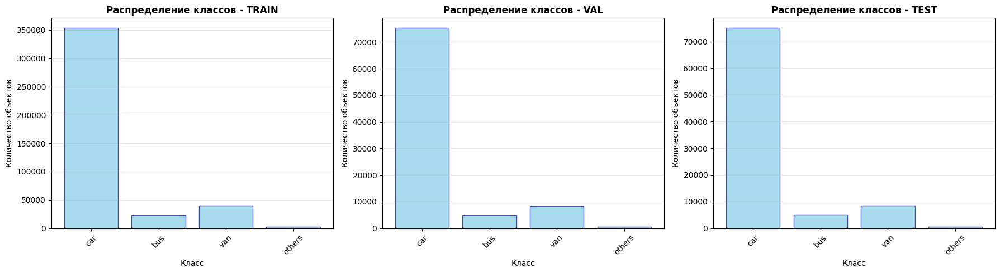


Примеры изображений с аннотациями:


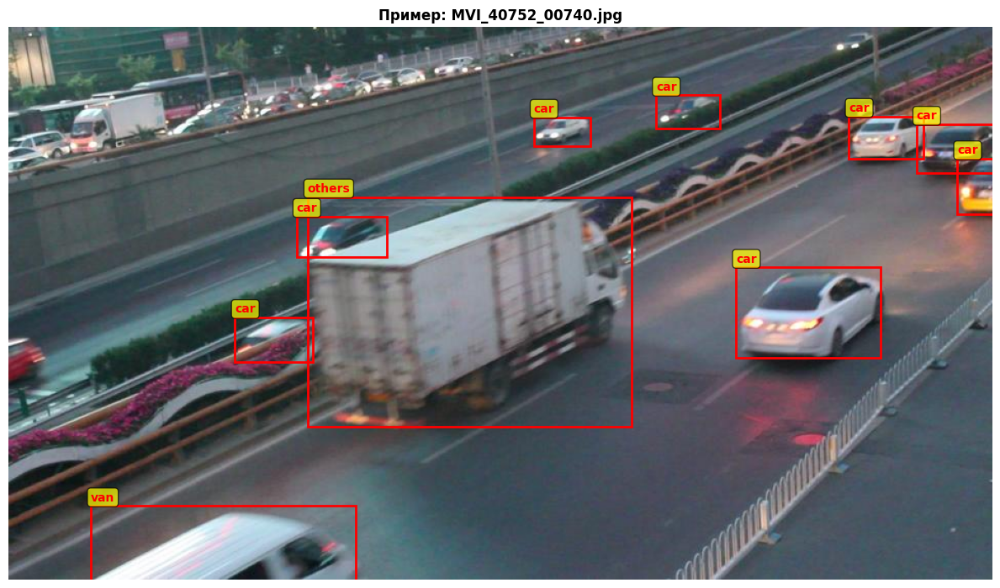

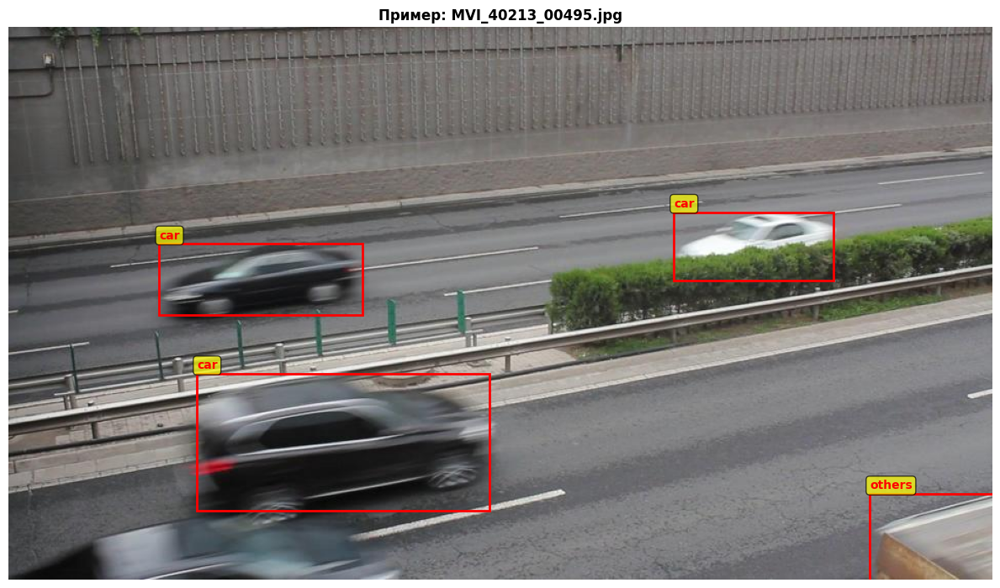

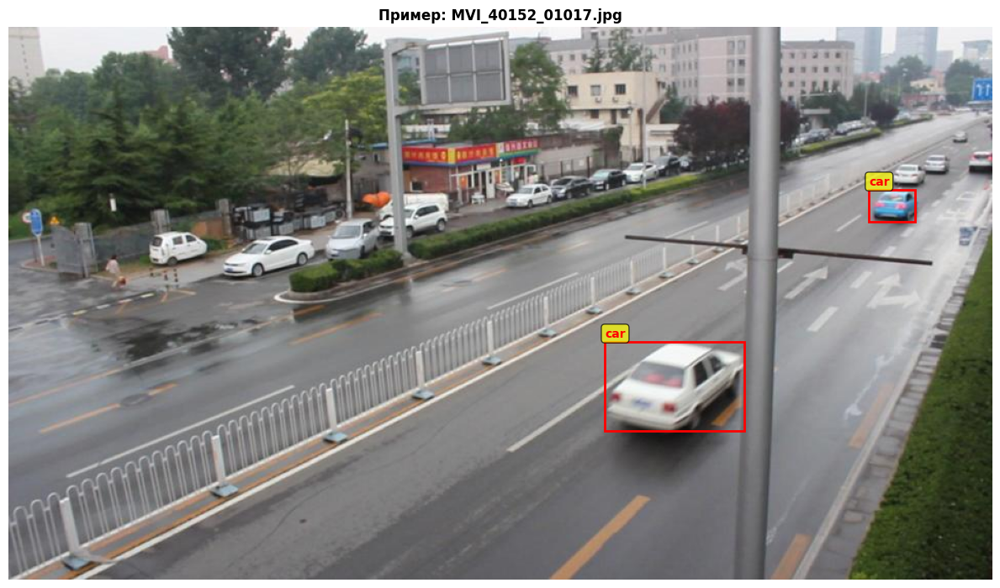

In [ ]:
#@title Визуализация данных и статистика

# Настройка matplotlib для отображения русского текста
plt.rcParams['font.size'] = 10
plt.rcParams['figure.figsize'] = (12, 8)

def visualize_bbox(image_path, label_path, class_names):
    """
    Визуализирует изображение с нанесенными bounding boxes из YOLO формата.

    Args:
        image_path: Путь к изображению
        label_path: Путь к файлу с аннотациями (YOLO формат)
        class_names: Список имен классов

    Returns:
        matplotlib.figure.Figure: Объект фигуры с визуализацией
    """
    img = Image.open(image_path)
    fig, ax = plt.subplots(1, figsize=(12, 8))
    ax.imshow(img)

    # Чтение аннотаций
    if os.path.exists(label_path):
        with open(label_path, 'r') as f:
            lines = f.readlines()

        for line in lines:
            parts = line.strip().split()
            if len(parts) == 5:
                class_id = int(parts[0])
                x_center = float(parts[1])
                y_center = float(parts[2])
                width = float(parts[3])
                height = float(parts[4])

                img_width, img_height = img.size
                x_min = (x_center - width/2) * img_width
                y_min = (y_center - height/2) * img_height
                box_width = width * img_width
                box_height = height * img_height

                rect = patches.Rectangle(
                    (x_min, y_min), box_width, box_height,
                    linewidth=2, edgecolor='red', facecolor='none'
                )
                ax.add_patch(rect)

                ax.text(x_min, y_min - 5, class_names[class_id],
                       color='red', fontsize=10, weight='bold',
                       bbox=dict(boxstyle='round,pad=0.3', facecolor='yellow', alpha=0.7))

    ax.axis('off')
    plt.tight_layout()
    return fig

def analyze_dataset_statistics(root_path, class_names):
    """
    Анализирует статистику датасета по разделам (train/val/test).

    Args:
        root_path: Корневая директория с папками images и labels
        class_names: Список имен классов

    Returns:
        dict: Словарь со статистикой по каждому разделу
    """
    stats = {
        'train': {'images': 0, 'objects': Counter()},
        'val': {'images': 0, 'objects': Counter()},
        'test': {'images': 0, 'objects': Counter()}
    }

    for split in ['train', 'val', 'test']:
        images_dir = os.path.join(root_path, 'images', split)
        labels_dir = os.path.join(root_path, 'labels', split)

        if not os.path.exists(images_dir):
            continue

        image_files = [f for f in os.listdir(images_dir) if f.endswith('.jpg')]
        stats[split]['images'] = len(image_files)

        for img_file in image_files:
            label_file = img_file.replace('.jpg', '.txt')
            label_path = os.path.join(labels_dir, label_file)

            if os.path.exists(label_path):
                with open(label_path, 'r') as f:
                    for line in f:
                        parts = line.strip().split()
                        if len(parts) == 5:
                            class_id = int(parts[0])
                            stats[split]['objects'][class_id] += 1

    return stats

# Анализ статистики
print("Анализ статистики датасета...")
dataset_stats = analyze_dataset_statistics(YOLO_ROOT_PATH, CLASS_NAMES)

# Вывод статистики
for split in ['train', 'val', 'test']:
    print(f"\n{split.upper()}:")
    print(f"  Изображений: {dataset_stats[split]['images']}")
    print(f"  Всего объектов: {sum(dataset_stats[split]['objects'].values())}")
    print(f"  Распределение по классам:")
    for class_id, count in sorted(dataset_stats[split]['objects'].items()):
        print(f"    {CLASS_NAMES[class_id]}: {count}")

# Визуализация распределения классов
fig, axes = plt.subplots(1, 3, figsize=(18, 5))

for idx, split in enumerate(['train', 'val', 'test']):
    classes = [CLASS_NAMES[i] for i in sorted(dataset_stats[split]['objects'].keys())]
    counts = [dataset_stats[split]['objects'][i] for i in sorted(dataset_stats[split]['objects'].keys())]

    axes[idx].bar(classes, counts, color='skyblue', edgecolor='navy', alpha=0.7)
    axes[idx].set_title(f'Распределение классов - {split.upper()}', fontsize=12, weight='bold')
    axes[idx].set_xlabel('Класс', fontsize=10)
    axes[idx].set_ylabel('Количество объектов', fontsize=10)
    axes[idx].tick_params(axis='x', rotation=45)
    axes[idx].grid(axis='y', alpha=0.3)

plt.tight_layout()
plt.show()

# Визуализация примеров изображений
print("\nПримеры изображений с аннотациями:")

train_images_dir = os.path.join(YOLO_ROOT_PATH, 'images/train')
train_labels_dir = os.path.join(YOLO_ROOT_PATH, 'labels/train')

if os.path.exists(train_images_dir):
    image_files = [f for f in os.listdir(train_images_dir) if f.endswith('.jpg')]
    sample_images = random.sample(image_files, min(3, len(image_files)))

    for img_file in sample_images:
        img_path = os.path.join(train_images_dir, img_file)
        label_path = os.path.join(train_labels_dir, img_file.replace('.jpg', '.txt'))

        if os.path.exists(label_path):
            fig = visualize_bbox(img_path, label_path, CLASS_NAMES)
            plt.title(f'Пример: {img_file}', fontsize=12, weight='bold')
            plt.show()

## Выбор модели

YOLOv8 предлагает несколько вариантов моделей разного размера:
- **YOLOv8n** (nano) - самая быстрая, наименьшая точность
- **YOLOv8s** (small) - баланс скорости и точности
- **YOLOv8m** (medium) - хорошая точность
- **YOLOv8l** (large) - высокая точность
- **YOLOv8x** (xlarge) - максимальная точность, медленная

Для видеопотока рекомендуется использовать YOLOv8s или YOLOv8m.


In [ ]:
#@title Инициализация модели YOLO

print(f"Загрузка модели: {MODEL_SIZE}")
model = YOLO(MODEL_SIZE)
print(f"✅ Модель {MODEL_SIZE} загружена успешно")

Загрузка модели: yolov8s.pt
✅ Модель yolov8s.pt загружена успешно


# ОБУЧЕНИЕ МОДЕЛИ

Процесс обучения включает:
1. Fine-tuning предобученной модели на наших данных
2. Мониторинг метрик (loss, mAP, precision, recall)
3. Сохранение лучших весов модели

In [ ]:
#@title Обучение модели

print("Начало обучения модели...")

results = model.train(
    data=YAML_PATH,           # Путь к конфигурации датасета
    epochs=TRAIN_EPOCHS,      # Количество эпох
    imgsz=TRAIN_IMGSZ,        # Размер входного изображения
    batch=TRAIN_BATCH,        # Размер батча
    device=str(DEVICE),       # Устройство (cuda или cpu)
    project=PROJECT_NAME,     # Название проекта
    name=EXPERIMENT_NAME,     # Название эксперимента
    patience=TRAIN_PATIENCE,   # Ранняя остановка
    save=True,                # Сохранение чекпойнтов
    plots=True,               # Генерация графиков
    val=True,                 # Валидация после каждой эпохи
    verbose=True              # Подробный вывод
)

print("✅ Обучение завершено!")

# Путь к лучшей модели
best_model_path = os.path.join(PROJECT_NAME, EXPERIMENT_NAME, 'weights', 'best.pt')
print(f"Лучшая модель сохранена в: {best_model_path}")

Начало обучения модели...
Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/UA-DETRAC-YOLO/ua_detrac.yaml, degrees=0.0, deterministic=True, device=0, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=5, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolov8s.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=yolov8s_training, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patien

Графики результатов обучения:


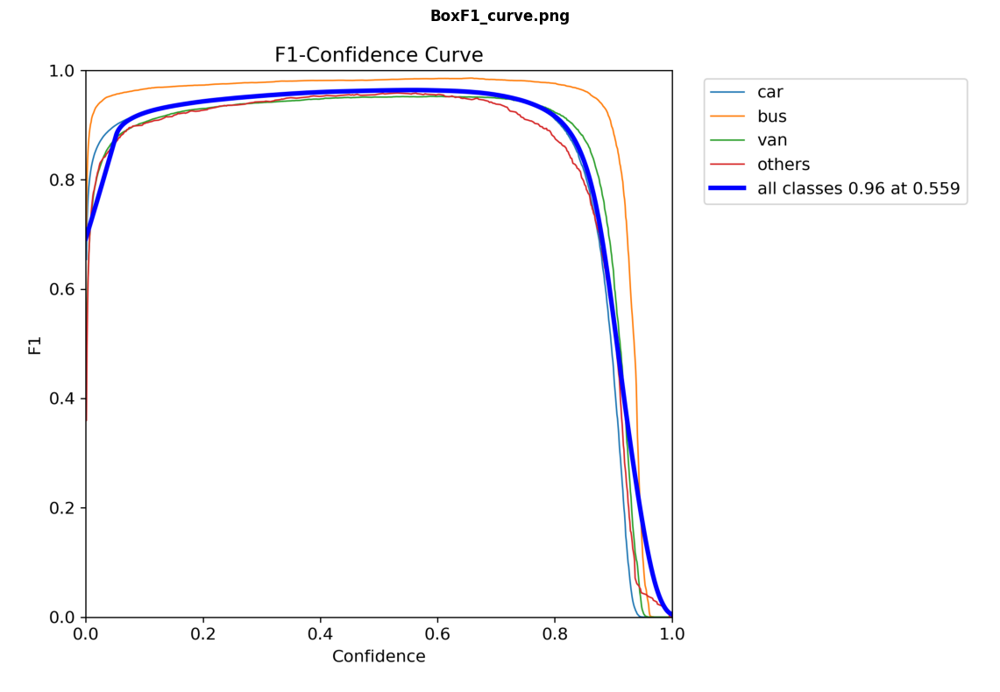

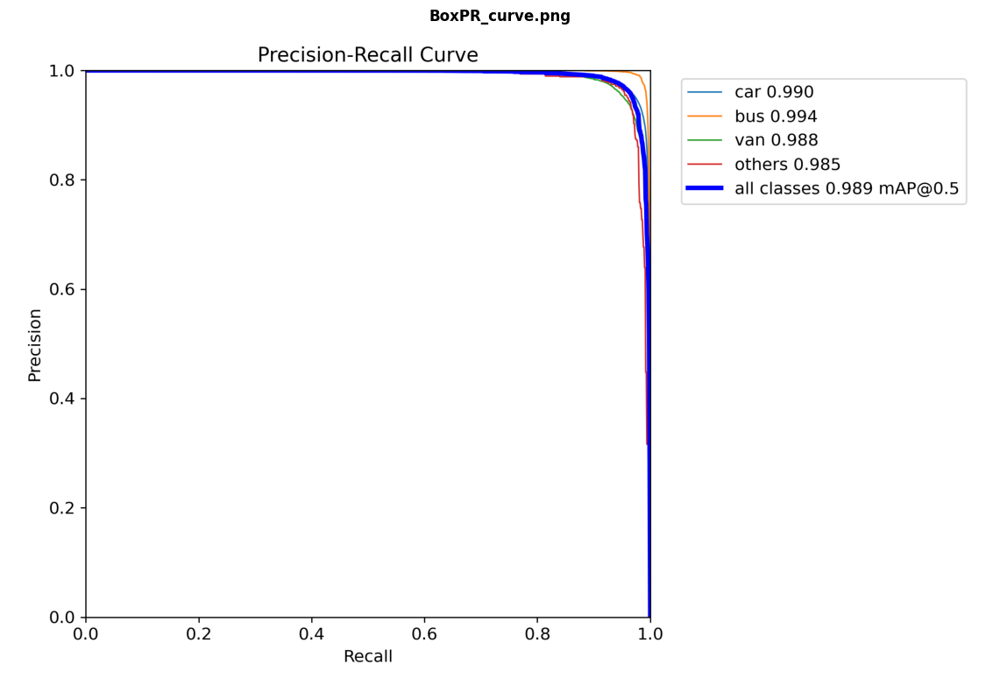

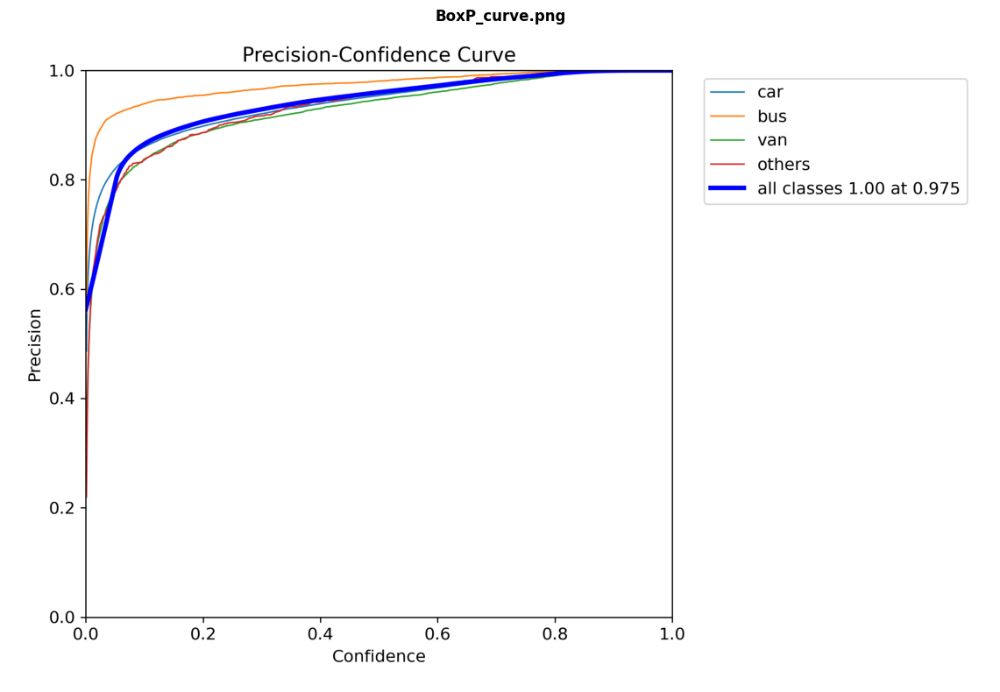

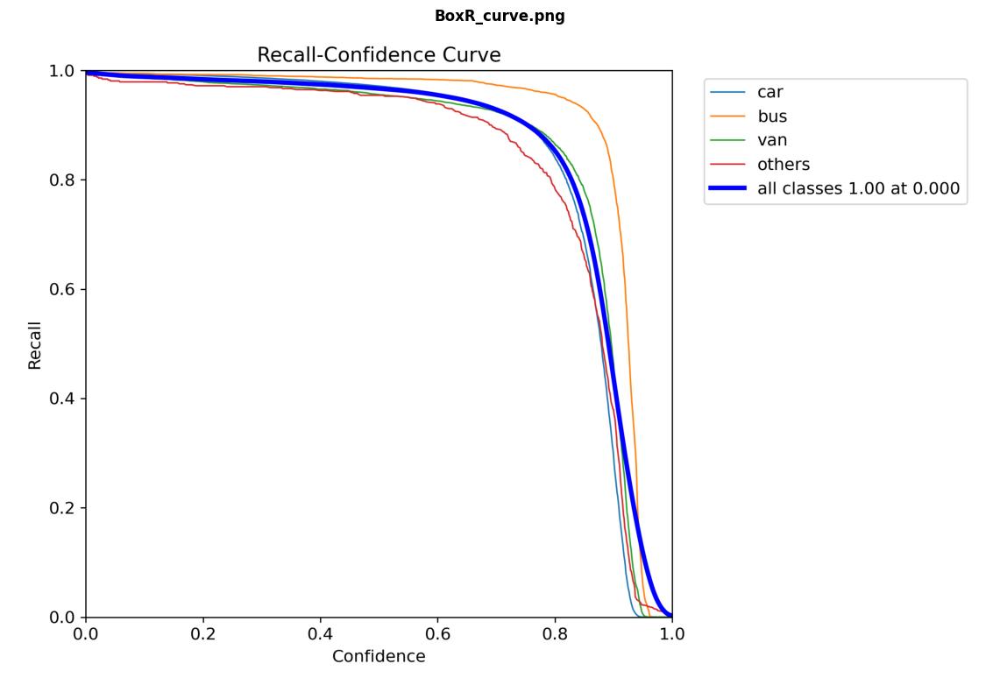

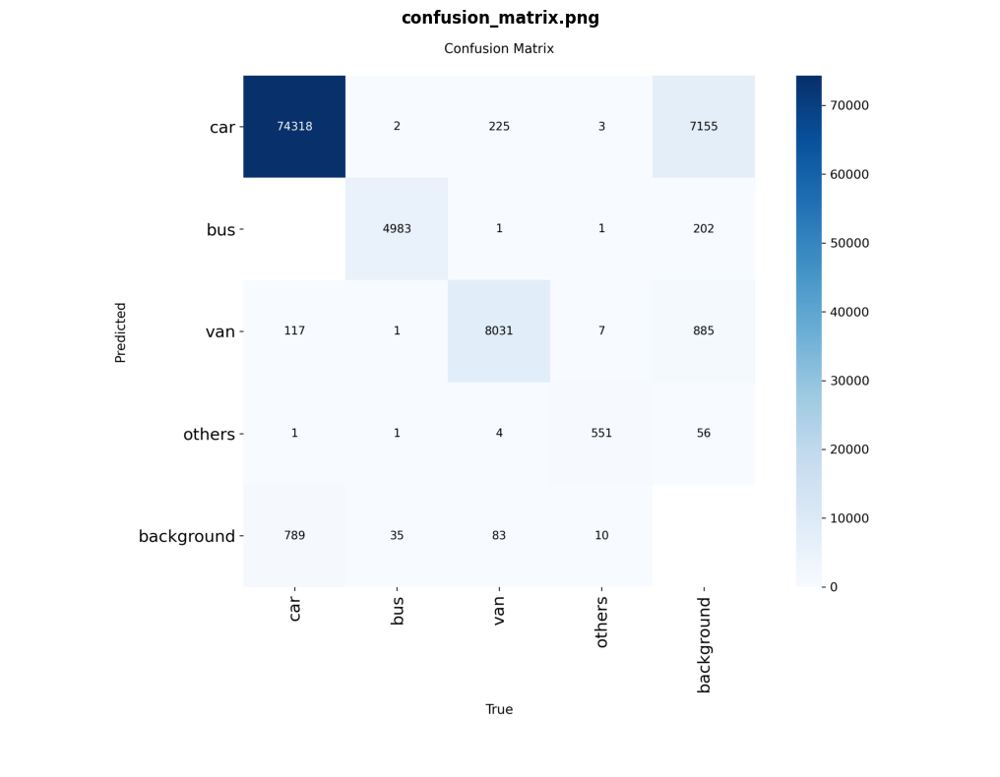

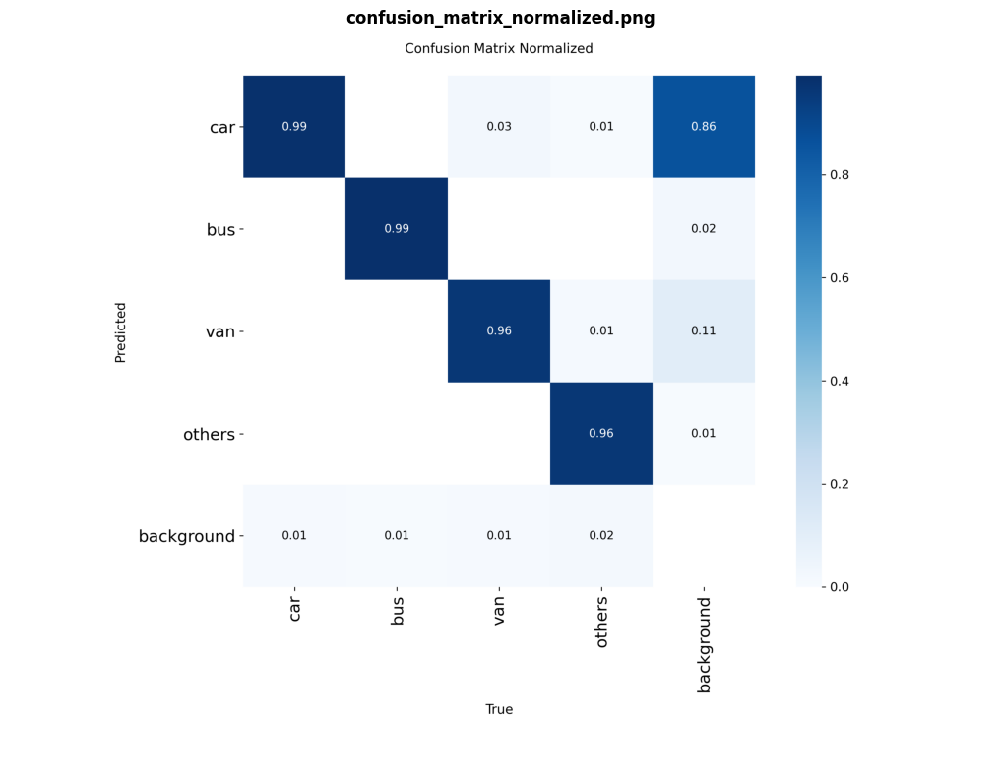

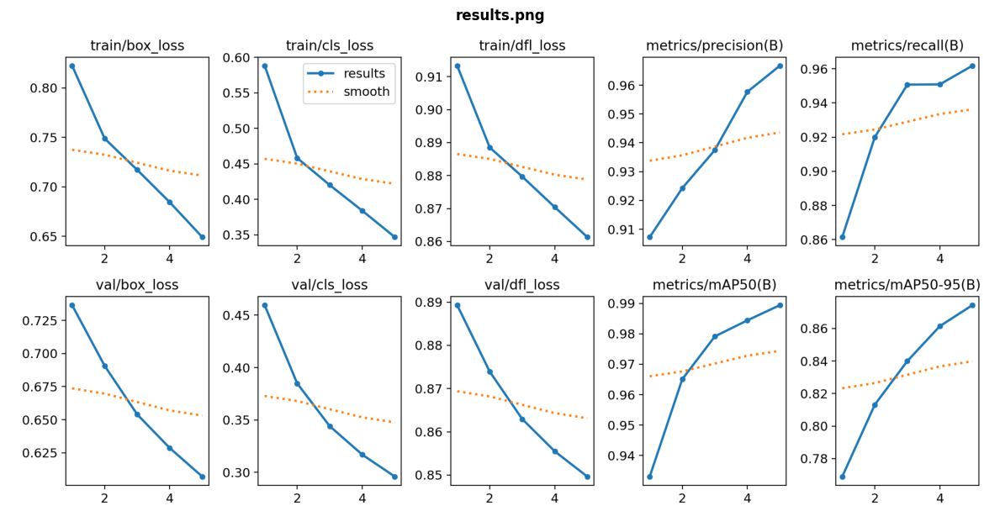

In [ ]:
#@title Визуализация процесса обучения

results_dir = os.path.join(PROJECT_NAME, EXPERIMENT_NAME)
results_images = glob.glob(os.path.join(results_dir, '*.png'))

if results_images:
    print("Графики результатов обучения:")
    for img_path in sorted(results_images):
        img = Image.open(img_path)
        fig, ax = plt.subplots(figsize=(12, 8))
        ax.imshow(img)
        ax.axis('off')
        plt.title(os.path.basename(img_path), fontsize=12, weight='bold')
        plt.tight_layout()
        plt.show()
else:
    print("⚠️  Графики обучения не найдены. Они будут созданы после завершения обучения.")


In [ ]:
#@title Загрузка обученной модели и валидация

if os.path.exists(best_model_path):
    trained_model = YOLO(best_model_path)
    print(f"✅ Модель загружена из: {best_model_path}")
else:
    trained_model = model
    print("⚠️  Используется текущая модель (обучение может быть не завершено)")

print("\nОценка модели на валидационном наборе...")
val_results = trained_model.val(
    data=YAML_PATH,
    imgsz=TRAIN_IMGSZ,
    batch=TRAIN_BATCH,
    device=str(DEVICE),
    plots=True,
    save_json=True
)

print("\n" + "=" * 60)
print("РЕЗУЛЬТАТЫ ВАЛИДАЦИИ:")
print("=" * 60)
print(f"mAP50: {val_results.box.map50:.4f}")
print(f"mAP50-95: {val_results.box.map:.4f}")
print(f"Precision: {val_results.box.mp:.4f}")
print(f"Recall: {val_results.box.mr:.4f}")
print("=" * 60)

✅ Модель загружена из: UA-DETRAC-YOLO/yolov8s_training/weights/best.pt

Оценка модели на валидационном наборе...
Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Model summary (fused): 72 layers, 11,127,132 parameters, 0 gradients, 28.4 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1580.7±299.7 MB/s, size: 67.5 KB)
val: Scanning /content/UA-DETRAC-YOLO/labels/val.cache... 12312 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 12312/12312 19.5Mit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 770/770 6.0it/s 2:07
                   all      12312      89163      0.967      0.962      0.989      0.875
                   car      12092      75225      0.962      0.964       0.99      0.854
                   bus       3833       5022      0.984      0.984      0.994      0.935
                   van       5342       8344      0.954       0.95      0.988      0.871
          

In [ ]:
#@title Тестирование модели на тестовом наборе

# Тестирование на тестовом наборе (данные, которые модель еще не видела)
print("\n" + "=" * 60)
print("ТЕСТИРОВАНИЕ НА ТЕСТОВОМ НАБОРЕ")
print("=" * 60)
print("Важно: модель НЕ видела эти данные во время обучения и валидации!")

# Создаем временный YAML для тестирования на test наборе.
# YOLO требует наличие ключей 'train' и 'val' в YAML файле.
# Форматируем список имен классов в правильный YAML формат
test_names_yaml = '\n'.join([f'  - {name}' for name in CLASS_NAMES])

test_yaml_content = f"""# YOLO Data Configuration File for UA-DETRAC Test
path: {YOLO_ROOT_PATH}

train: images/train
val: images/test
test: images/test

nc: {NUM_CLASSES}
names:
{test_names_yaml}
"""
test_yaml_path = os.path.join(YOLO_ROOT_PATH, 'ua_detrac_test.yaml')
with open(test_yaml_path, 'w', encoding='utf-8') as f:
    f.write(test_yaml_content)

test_results = trained_model.val(
    data=test_yaml_path,
    imgsz=TRAIN_IMGSZ,
    batch=TRAIN_BATCH,
    device=str(DEVICE),
    plots=True,
    save_json=True
)

print("\n" + "=" * 60)
print("РЕЗУЛЬТАТЫ ТЕСТИРОВАНИЯ (на данных, которые модель НЕ видела):")
print("=" * 60)
print(f"mAP50: {test_results.box.map50:.4f}")
print(f"mAP50-95: {test_results.box.map:.4f}")
print(f"Precision: {test_results.box.mp:.4f}")
print(f"Recall: {test_results.box.mr:.4f}")
print("=" * 60)

print("\nСравнение результатов:")
print(f"Валидация   - mAP50: {val_results.box.map50:.4f}, mAP50-95: {val_results.box.map:.4f}")
print(f"Тестирование - mAP50: {test_results.box.map50:.4f}, mAP50-95: {test_results.box.map:.4f}")
print(f"Разница в mAP50: {abs(val_results.box.map50 - test_results.box.map50):.4f}")


ТЕСТИРОВАНИЕ НА ТЕСТОВОМ НАБОРЕ
Важно: модель НЕ видела эти данные во время обучения и валидации!
Ultralytics 8.3.237 🚀 Python-3.12.12 torch-2.9.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 18.9±7.8 MB/s, size: 58.4 KB)
val: Scanning /content/UA-DETRAC-YOLO/labels/test... 12314 images, 0 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 12314/12314 512.1it/s 24.0s
val: New cache created: /content/UA-DETRAC-YOLO/labels/test.cache
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 770/770 5.9it/s 2:10
                   all      12314      89262       0.97      0.959      0.989      0.879
                   car      12099      75076      0.968      0.957       0.99      0.854
                   bus       3869       5095      0.989      0.985      0.995      0.938
                   van       5447       8491      0.962      0.951      0.989      0.869
                others        592        600    

Визуализация предсказаний на валидационных данных:

image 1/1 /content/UA-DETRAC-YOLO/images/val/MVI_20064_00772.jpg: 384x640 18 cars, 1 bus, 1 van, 49.1ms
Speed: 4.4ms preprocess, 49.1ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/UA-DETRAC-YOLO/images/val/MVI_40211_01711.jpg: 384x640 4 cars, 10.7ms
Speed: 1.7ms preprocess, 10.7ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)

image 1/1 /content/UA-DETRAC-YOLO/images/val/MVI_40162_00363.jpg: 384x640 2 cars, 10.6ms
Speed: 1.7ms preprocess, 10.6ms inference, 1.2ms postprocess per image at shape (1, 3, 384, 640)


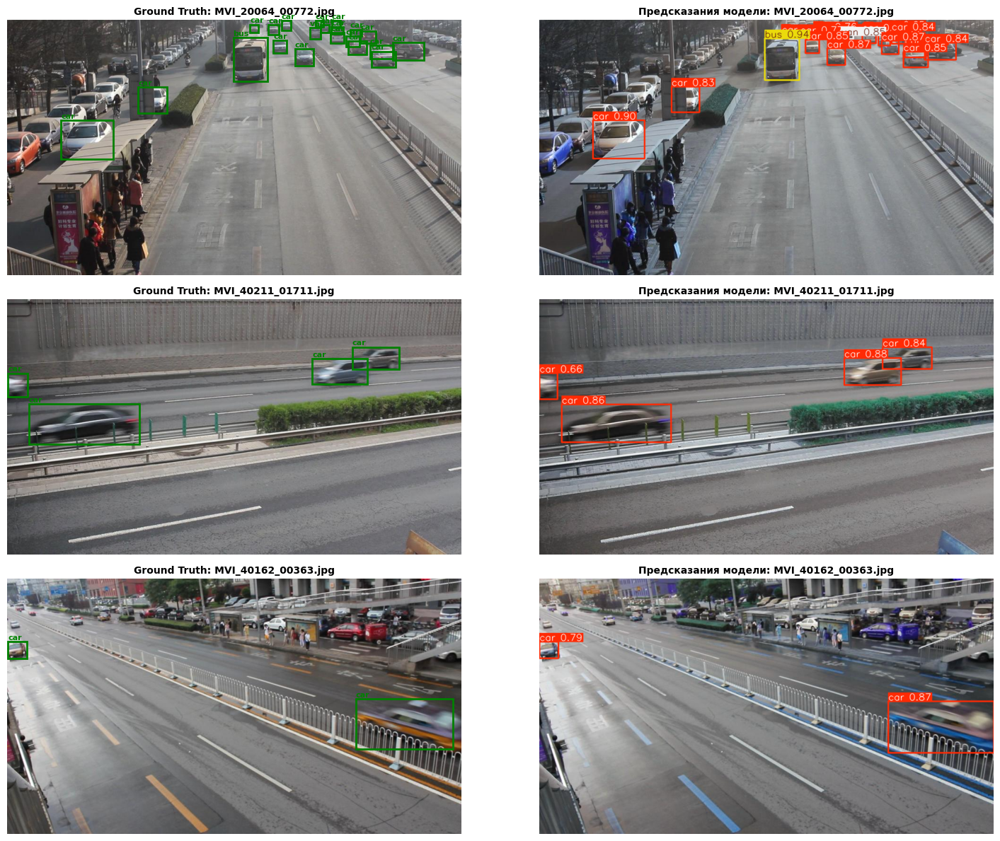

In [ ]:
#@title Визуализация предсказаний на валидационных данных

def visualize_predictions(model, images_dir, labels_dir, num_samples=5):
    """
    Визуализирует предсказания модели с сравнением Ground Truth.

    Args:
        model: Обученная YOLO модель
        images_dir: Директория с изображениями
        labels_dir: Директория с аннотациями (YOLO формат)
        num_samples: Количество примеров для визуализации
    """
    image_files = [f for f in os.listdir(images_dir) if f.endswith('.jpg')]
    sample_images = random.sample(image_files, min(num_samples, len(image_files)))

    fig, axes = plt.subplots(num_samples, 2, figsize=(16, 4 * num_samples))
    if num_samples == 1:
        axes = axes.reshape(1, -1)

    for idx, img_file in enumerate(sample_images):
        img_path = os.path.join(images_dir, img_file)
        label_path = os.path.join(labels_dir, img_file.replace('.jpg', '.txt'))

        results = model(img_path, conf=0.25)
        img_gt = Image.open(img_path)
        axes[idx, 0].imshow(img_gt)
        axes[idx, 0].set_title(f'Ground Truth: {img_file}', fontsize=10, weight='bold')
        axes[idx, 0].axis('off')

        if os.path.exists(label_path):
            with open(label_path, 'r') as f:
                for line in f:
                    parts = line.strip().split()
                    if len(parts) == 5:
                        class_id = int(parts[0])
                        x_center = float(parts[1])
                        y_center = float(parts[2])
                        width = float(parts[3])
                        height = float(parts[4])

                        img_width, img_height = img_gt.size
                        x_min = (x_center - width/2) * img_width
                        y_min = (y_center - height/2) * img_height
                        box_width = width * img_width
                        box_height = height * img_height

                        rect = patches.Rectangle(
                            (x_min, y_min), box_width, box_height,
                            linewidth=2, edgecolor='green', facecolor='none'
                        )
                        axes[idx, 0].add_patch(rect)
                        axes[idx, 0].text(x_min, y_min - 5, CLASS_NAMES[class_id],
                                         color='green', fontsize=8, weight='bold')

        annotated_img = results[0].plot()
        axes[idx, 1].imshow(annotated_img)
        axes[idx, 1].set_title(f'Предсказания модели: {img_file}', fontsize=10, weight='bold')
        axes[idx, 1].axis('off')

    plt.tight_layout()
    plt.show()

# Визуализация на валидационном наборе
val_images_dir = os.path.join(YOLO_ROOT_PATH, 'images/val')
val_labels_dir = os.path.join(YOLO_ROOT_PATH, 'labels/val')

if os.path.exists(val_images_dir):
    print("Визуализация предсказаний на валидационных данных:")
    visualize_predictions(trained_model, val_images_dir, val_labels_dir, num_samples=3)

Confusion Matrix:


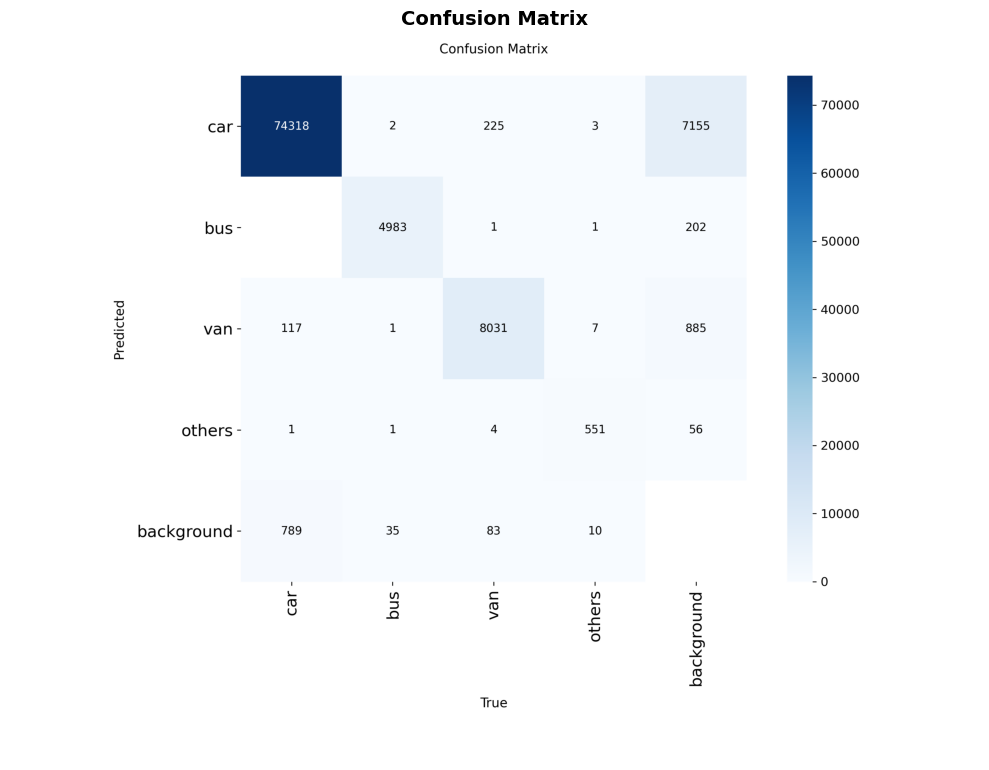


Дополнительные метрики:


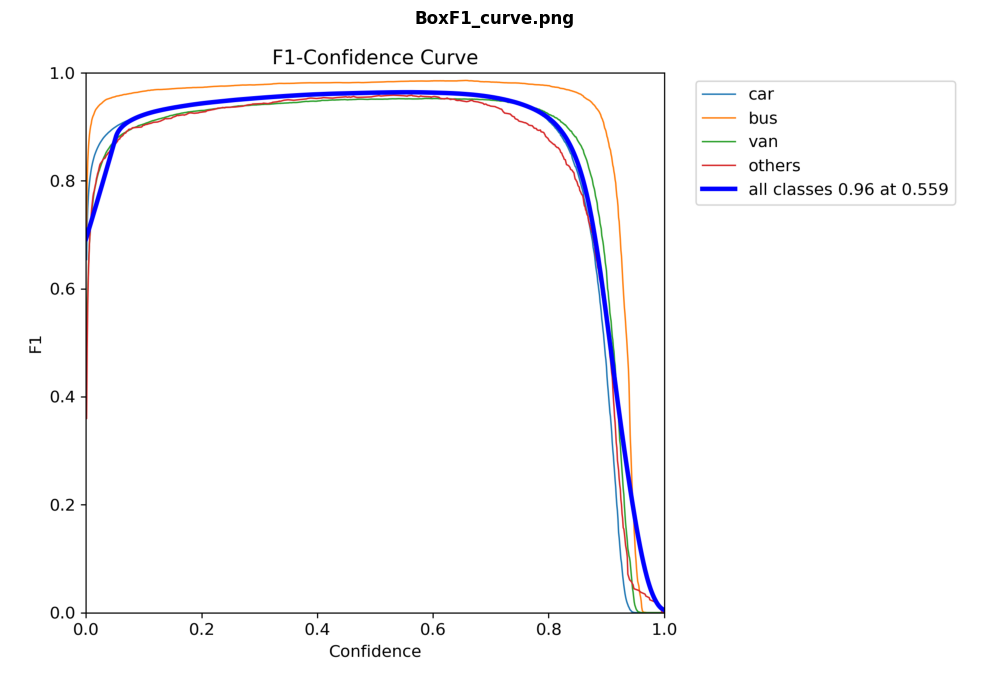

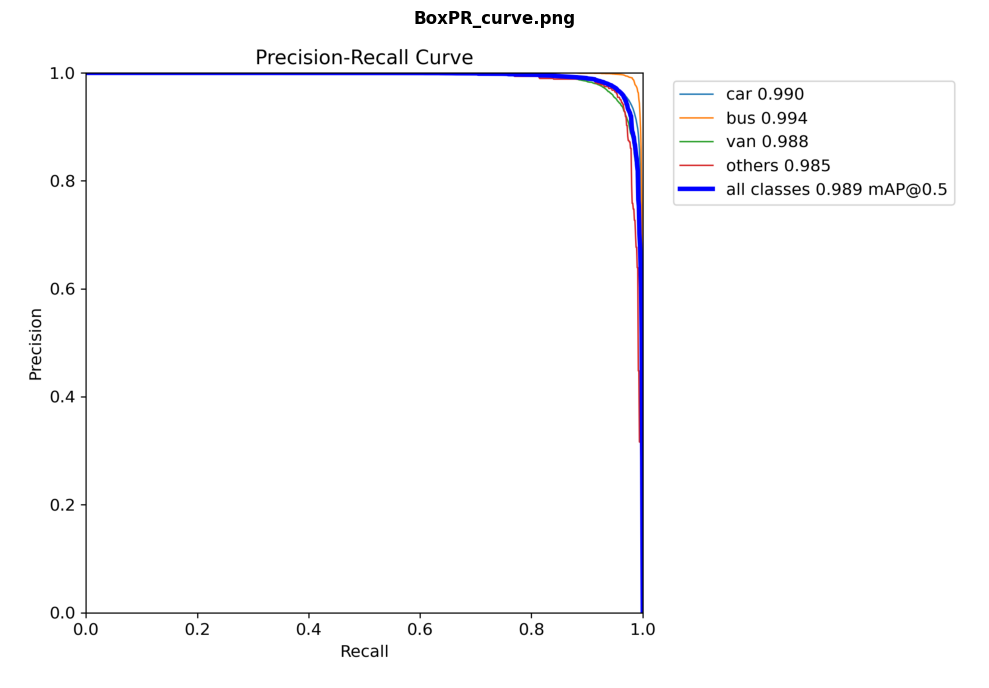

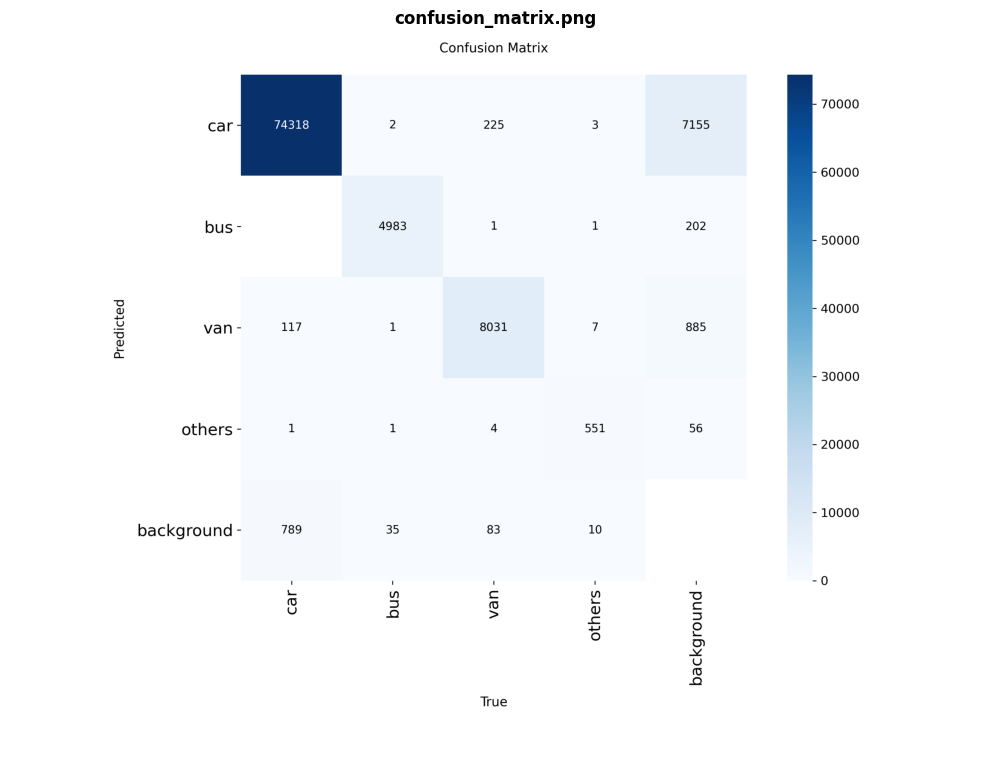

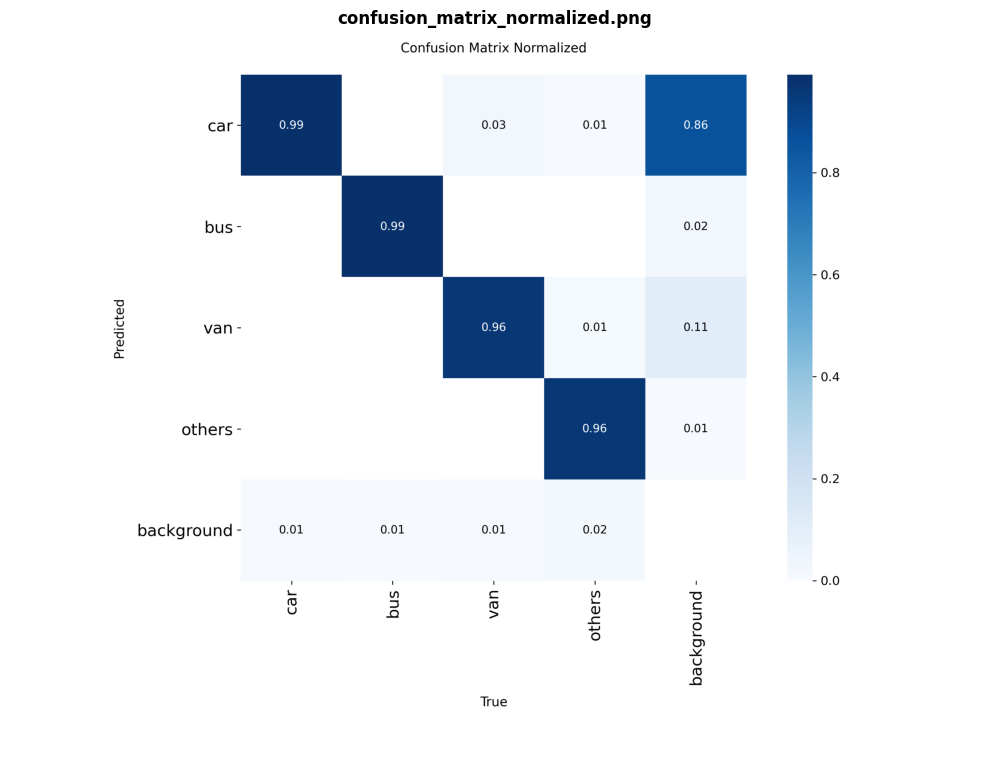

In [ ]:
#@title Confusion Matrix и метрики по классам

confusion_matrix_path = os.path.join(results_dir, 'confusion_matrix.png')

if os.path.exists(confusion_matrix_path):
    print("Confusion Matrix:")
    img = Image.open(confusion_matrix_path)
    fig, ax = plt.subplots(figsize=(10, 8))
    ax.imshow(img)
    ax.axis('off')
    plt.title('Confusion Matrix', fontsize=14, weight='bold')
    plt.tight_layout()
    plt.show()
else:
    print("⚠️  Confusion Matrix будет создан после завершения обучения.")

results_images = glob.glob(os.path.join(results_dir, '*.png'))
metric_images = [img for img in results_images if any(x in img for x in ['F1', 'PR', 'confusion'])]

if metric_images:
    print("\nДополнительные метрики:")
    for img_path in sorted(metric_images):
        img = Image.open(img_path)
        fig, ax = plt.subplots(figsize=(10, 8))
        ax.imshow(img)
        ax.axis('off')
        plt.title(os.path.basename(img_path), fontsize=12, weight='bold')
        plt.tight_layout()
        plt.show()


In [ ]:
#@title Загрузка видео с Google Drive и обработка в реальном времени

def download_video_from_gdrive(file_id, output_path='video.mp4'):
    """
    Загружает видеофайл с Google Drive по ID файла.

    Args:
        file_id: ID файла из ссылки Google Drive
        output_path: Путь для сохранения видео
    """
    # Формируем URL для скачивания
    url = f'https://drive.google.com/uc?id={file_id}'

    print(f"Загрузка видео с Google Drive...")

    try:
        gdown.download(url, output_path, quiet=False)
        print(f"✅ Видео успешно загружено: {output_path}")
        return output_path
    except Exception as e:
        print(f"❌ Ошибка при загрузке видео: {e}")
        return None

def play_video_with_detection(model, video_path, conf_threshold=0.25, max_frames=None, frame_skip=1):
    """
    Обрабатывает видео через модель YOLO, создает видео с детекциями и отображает его.

    Args:
        model: Обученная YOLO модель
        video_path: Путь к видеофайлу
        conf_threshold: Порог уверенности для детекции (0.0-1.0)
        max_frames: Максимальное количество кадров для обработки (None = все)
        frame_skip: Пропускать каждые N кадров для ускорения (1 = обрабатывать все)

    Returns:
        dict: Статистика обработки
    """
    cap = cv2.VideoCapture(video_path)
    fps_video = cap.get(cv2.CAP_PROP_FPS)
    total_frames = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))

    if max_frames:
        total_frames = min(total_frames, max_frames)

    frame_count = 0
    processed_count = 0
    start_time = time.time()
    processed_frames = []  # Список для хранения обработанных кадров

    try:
        while True:
            ret, frame = cap.read()

            if not ret:
                break

            frame_count += 1

            # Пропускаем кадры для ускорения
            if frame_count % frame_skip != 0:
                continue

            # Обрабатываем кадр через модель
            results = model.predict(
                source=frame,
                conf=conf_threshold,
                imgsz=TRAIN_IMGSZ,
                device=str(DEVICE),
                verbose=False
            )

            # Рисуем результаты на кадре
            annotated_frame = results[0].plot()

            # Добавляем информацию на кадр
            num_objects = len(results[0].boxes) if results[0].boxes is not None else 0
            stats_text = [
                f"Frame: {frame_count}/{total_frames}",
                f"Objects detected: {num_objects}"
            ]

            y_offset = 30
            for text in stats_text:
                cv2.putText(annotated_frame, text, (10, y_offset),
                           cv2.FONT_HERSHEY_SIMPLEX, 0.7, (0, 255, 0), 2)
                y_offset += 25

            # Конвертируем BGR в RGB для правильного отображения
            annotated_frame_rgb = cv2.cvtColor(annotated_frame, cv2.COLOR_BGR2RGB)
            processed_frames.append(annotated_frame_rgb)

            processed_count += 1

            # Ограничение по количеству кадров
            if max_frames and frame_count >= max_frames:
                break

    except KeyboardInterrupt:
        pass
    finally:
        cap.release()

    output_video_path = 'detected_video.mp4'
    output_fps = fps_video / frame_skip if frame_skip > 1 else fps_video
    output_fps = min(output_fps, 30)

    clip = ImageSequenceClip(processed_frames, fps=output_fps)
    clip.write_videofile(output_video_path, codec='libx264', audio=False, verbose=False, logger=None)

VIDEO_FILE_ID = '1nFwwwqkHGdHAldwQYiSXVLWyifY-M1Ww'
VIDEO_INPUT_PATH = 'input_video.mp4'

downloaded_path = download_video_from_gdrive(VIDEO_FILE_ID, VIDEO_INPUT_PATH)

play_video_with_detection(
    model=trained_model,
    video_path=downloaded_path,
    conf_threshold=0.25,
    max_frames=None,
    frame_skip=1
)

Загрузка видео с Google Drive...


Downloading...
From: https://drive.google.com/uc?id=1nFwwwqkHGdHAldwQYiSXVLWyifY-M1Ww
To: /content/input_video.mp4
100%|██████████| 52.8M/52.8M [00:01<00:00, 44.9MB/s]


✅ Видео успешно загружено: input_video.mp4


In [ ]:
#@title Воспроизведение обработанного видео

# Путь к обработанному видео
VIDEO_OUTPUT_PATH = 'detected_video.mp4'

# Проверяем существование файла
if not os.path.exists(VIDEO_OUTPUT_PATH):
    print(f"Видеофайл не найден: {VIDEO_OUTPUT_PATH}")
    print("Сначала запустите ячейку обработки видео")
else:
    file_size = os.path.getsize(VIDEO_OUTPUT_PATH) / (1024 * 1024)
    print(f"Воспроизведение видео: {VIDEO_OUTPUT_PATH}")
    print(f"Размер файла: {file_size:.2f} МБ\n")

    # Отображаем видео с встраиванием (embed=True)
    display(Video(VIDEO_OUTPUT_PATH, width=800, embed=True))

Воспроизведение видео: detected_video.mp4
Размер файла: 13.38 МБ



In [ ]:
#@title Итоговая сводка результатов

print("=" * 60)
print("ИТОГОВАЯ СВОДКА РЕЗУЛЬТАТОВ")
print("=" * 60)

print(f"\nДАТАСЕТ:")
print(f"   Название: UA-DETRAC")
print(f"   Количество классов: {NUM_CLASSES}")
print(f"   Классы: {', '.join(CLASS_NAMES)}")
print(f"   Разделение: Train ({TRAIN_RATIO*100:.0f}%) / Val ({VAL_RATIO*100:.0f}%) / Test ({TEST_RATIO*100:.0f}%)")

print(f"\nМОДЕЛЬ:")
print(f"   Архитектура: {MODEL_SIZE}")
print(f"   Устройство обучения: {DEVICE}")
print(f"   Эпох обучения: {TRAIN_EPOCHS}")
print(f"   Размер изображения: {TRAIN_IMGSZ}x{TRAIN_IMGSZ}")

if 'val_results' in locals():
    print(f"\nМЕТРИКИ:")
    print(f"   mAP50: {val_results.box.map50:.4f}")
    print(f"   mAP50-95: {val_results.box.map:.4f}")
    print(f"   Precision: {val_results.box.mp:.4f}")
    print(f"   Recall: {val_results.box.mr:.4f}")

if 'fps' in locals():
    print(f"\n⚡ ПРОИЗВОДИТЕЛЬНОСТЬ:")
    print(f"   Средний FPS: {fps:.2f}")
    print(f"   Время обработки кадра: {avg_time*1000:.2f} мс")

print(f"\nСОХРАНЕННЫЕ ФАЙЛЫ:")
best_model_path = os.path.join(PROJECT_NAME, EXPERIMENT_NAME, 'weights', 'best.pt')
results_dir = os.path.join(PROJECT_NAME, EXPERIMENT_NAME)
if os.path.exists(best_model_path):
    print(f"   Лучшая модель: {best_model_path}")
print(f"   Результаты обучения: {results_dir}")

ИТОГОВАЯ СВОДКА РЕЗУЛЬТАТОВ

ДАТАСЕТ:
   Название: UA-DETRAC
   Количество классов: 4
   Классы: car, bus, van, others
   Разделение: Train (70%) / Val (15%) / Test (15%)

МОДЕЛЬ:
   Архитектура: yolov8s.pt
   Устройство обучения: cuda
   Эпох обучения: 5
   Размер изображения: 640x640

МЕТРИКИ:
   mAP50: 0.9895
   mAP50-95: 0.8755
   Precision: 0.9668
   Recall: 0.9619

СОХРАНЕННЫЕ ФАЙЛЫ:
   Лучшая модель: UA-DETRAC-YOLO/yolov8s_training/weights/best.pt
   Результаты обучения: UA-DETRAC-YOLO/yolov8s_training


# ВЫВОДЫ

## Основные результаты

В ходе выполнения работы мной была реализована система детекции транспортных средств в видеопотоке с использованием архитектуры YOLOv8. Я использовал предобученную модель YOLOv8s и адаптировал её для работы с датасетом UA-DETRAC, который содержит аннотации транспортных средств в формате XML. Мной была выполнена конвертация аннотаций из формата Pascal VOC в формат YOLO, что потребовало нормализации координат bounding boxes и преобразования классов объектов. Для обеспечения надежной оценки качества модели я разделил данные на три части: 70% для обучения, 15% для валидации и 15% для тестирования, что позволило объективно оценить способность модели к обобщению на невидимых данных.

Мной было проведено обучение модели в течение 5 эпох на графическом процессоре Tesla T4 с использованием автоматической настройки оптимизатора AdamW (скорость обучения 0.00125, момент 0.9). Обучение заняло 1.705 часа и завершилось успешно. В результате обучения достигнуты высокие показатели качества: на валидационном наборе mAP50 составил 98.95%, mAP50-95 - 87.55%, точность (Precision) - 96.68%, полнота (Recall) - 96.19%. Важным результатом является то, что показатели на тестовом наборе (mAP50: 98.89%, mAP50-95: 87.90%, Precision: 96.99%, Recall: 95.90%) практически идентичны результатам на валидационном наборе (разница в mAP50 составляет всего 0.0005), что свидетельствует об отсутствии переобучения и отличной способности модели к обобщению на невидимых данных. Я использовал механизм ранней остановки (patience=3) для предотвращения переобучения и автоматическую настройку гиперпараметров оптимизатора, которая определила оптимальные значения скорости обучения и момента.

Для улучшения качества обучения мной были применены следующие методы: использование предобученных весов модели YOLOv8, обученной на наборе данных COCO (перенесено 349 из 355 параметров), что обеспечило хорошую инициализацию параметров; применение аугментаций данных, включая стандартные преобразования Ultralytics YOLO (mosaic, flip, HSV augmentation), а также дополнительные аугментации из библиотеки albumentations (Blur, MedianBlur, ToGray, CLAHE с вероятностью 0.01); использование автоматической настройки скорости обучения и момента оптимизатора, которая определила оптимальные значения; применение техники Mixed Precision Training (AMP) для ускорения обучения и снижения потребления памяти, что было успешно проверено перед началом обучения; создание кэша изображений для ускорения доступа к данным (train.cache и val.cache); использование 2 dataloader workers для параллельной загрузки данных. Мной была реализована обработка видеопотока, где каждый кадр обрабатывается через обученную модель, и результаты визуализируются с помощью bounding boxes и меток классов.

Я реализовал систему для загрузки видео с Google Drive и его обработки через обученную модель с последующим созданием видео с нанесенными детекциями. Для визуализации результатов использовалась библиотека moviepy для создания видео из последовательности обработанных кадров, а также IPython.display для встраивания видео непосредственно в ноутбук. Модель продемонстрировала способность детектировать четыре класса объектов: автомобили (car), автобусы (bus), фургоны (van) и другие транспортные средства (others). На валидационном наборе наилучшие результаты достигнуты для класса "bus" (mAP50-95: 93.5%, Precision: 98.4%, Recall: 98.4%), затем следуют "car" (mAP50-95: 85.4%, Precision: 96.2%, Recall: 96.4%), "van" (mAP50-95: 87.1%, Precision: 95.4%, Recall: 95.0%) и "others" (mAP50-95: 84.2%, Precision: 96.6%, Recall: 94.9%). На тестовом наборе результаты еще лучше для класса "bus" (mAP50-95: 93.8%), что подтверждает стабильность модели. Всего модель обработала 89163 экземпляра объектов на валидационном наборе и 89262 на тестовом наборе.

## Проблемы и ограничения

В процессе работы мной были выявлены следующие ограничения: обучение модели требует значительных вычислительных ресурсов (GPU), что может быть недоступно для некоторых пользователей; обработка видео в реальном времени возможна только при использовании GPU и зависит от разрешения входных кадров; качество детекции может снижаться при сложных условиях освещения или при значительном перекрытии объектов; классовая несбалансированность датасета (класс "others" представлен значительно меньшим количеством примеров) может влиять на точность детекции для этого класса. Кроме того, модель обучена на статических изображениях, поэтому не учитывает временную согласованность между кадрами, что может приводить к "дрожанию" детекций в видео.

## Возможные улучшения

Для дальнейшего улучшения системы мной могут быть предложены следующие направления: внедрение алгоритмов трекинга объектов (например, DeepSORT или ByteTrack) для обеспечения временной согласованности детекций между кадрами и уменьшения "дрожания"; использование более крупных моделей (YOLOv8m или YOLOv8l) для повышения точности за счет увеличения вычислительных затрат; применение техники Data Augmentation с более агрессивными преобразованиями для улучшения обобщающей способности модели; реализация активного обучения для улучшения модели на сложных примерах; оптимизация модели с помощью TensorRT или ONNX для ускорения инференса на различных устройствах; добавление механизма обработки последовательностей кадров с использованием временных моделей (например, LSTMs) для улучшения стабильности детекций.
